<a href="https://colab.research.google.com/github/NobodydeBunny/Cat_Dog_breed_classifire_AI_model/blob/main/cats_dogs_binary_classifier_imp_01/cats_dogs_binary_classifier_imp_01.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!wget https://download.microsoft.com/download/3/e/1/3e1c3f21-ecdb-4869-8368-6deba77b919f/kagglecatsanddogs_5340.zip

--2026-02-10 10:24:39--  https://download.microsoft.com/download/3/e/1/3e1c3f21-ecdb-4869-8368-6deba77b919f/kagglecatsanddogs_5340.zip
Resolving download.microsoft.com (download.microsoft.com)... 23.62.176.164, 2600:1406:bc00:1084::317f, 2600:1406:bc00:1085::317f
Connecting to download.microsoft.com (download.microsoft.com)|23.62.176.164|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 824887076 (787M) [application/octet-stream]
Saving to: ‘kagglecatsanddogs_5340.zip.2’

kagglecatsanddogs_5 100%[===================>] 786.67M  6.06MB/s    in 34s     

2026-02-10 10:25:13 (23.0 MB/s) - ‘kagglecatsanddogs_5340.zip.2’ saved [824887076/824887076]



In [ ]:
!unzip kagglecatsanddogs_5340.zip

Streaming output truncated to the last 5000 lines.
  inflating: PetImages/Dog/5500.jpg  
  inflating: PetImages/Dog/5501.jpg  
  inflating: PetImages/Dog/5502.jpg  
  inflating: PetImages/Dog/5503.jpg  
  inflating: PetImages/Dog/5504.jpg  
  inflating: PetImages/Dog/5505.jpg  
  inflating: PetImages/Dog/5506.jpg  
  inflating: PetImages/Dog/5507.jpg  
  inflating: PetImages/Dog/5508.jpg  
  inflating: PetImages/Dog/5509.jpg  
  inflating: PetImages/Dog/551.jpg   
  inflating: PetImages/Dog/5510.jpg  
  inflating: PetImages/Dog/5511.jpg  
  inflating: PetImages/Dog/5512.jpg  
  inflating: PetImages/Dog/5513.jpg  
  inflating: PetImages/Dog/5514.jpg  
  inflating: PetImages/Dog/5515.jpg  
  inflating: PetImages/Dog/5516.jpg  
  inflating: PetImages/Dog/5517.jpg  
  inflating: PetImages/Dog/5518.jpg  
  inflating: PetImages/Dog/5519.jpg  
  inflating: PetImages/Dog/552.jpg   
  inflating: PetImages/Dog/5520.jpg  
  inflating: PetImages/Dog/5521.jpg  
  inflating: PetImages/Dog/5522.jpg  

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import warnings
from keras.preprocessing.image import load_img
warnings.filterwarnings('ignore')
import os

In [ ]:
#Creating dataframe
input_path = []
label = []

for class_name in os.listdir("PetImages"):
  for path in os.listdir("PetImages/"+class_name):
    if class_name == 'Cat':
      label.append(0)
    else:
      label.append(1)
    input_path.append(os.path.join("PetImages",class_name,path))
print(input_path[0], label[0])
len(input_path)


PetImages/Dog/6402.jpg 1


25002

In [ ]:
df = pd.DataFrame()
df['input_path'] = input_path
df['label'] = label
df = df.sample(frac=1).reset_index(drop=True)
df.head()

,input_path,label
0,PetImages/Dog/9878.jpg,1
1,PetImages/Cat/3154.jpg,0
2,PetImages/Dog/494.jpg,1
3,PetImages/Dog/2163.jpg,1
4,PetImages/Dog/1827.jpg,1


In [ ]:
#Delete db files

for i in df ['input_path']:
  if '.db' in i:
    df.drop(df[df['input_path']==i].index, inplace=True)

In [ ]:
import PIL
l = []
print("Checking image validity...")
for image_path in df['input_path']:
  try:
    img = PIL.Image.open(image_path)
    img.verify()
  except (IOError, SyntaxError, PIL.UnidentifiedImageError) as e:
    l.append(image_path)

print(f"Identified {len(l)} unopenable image files.")
if l:
  print("These files will be removed:")
  for bad_file in l:
    print(bad_file)

Checking image validity...
Identified 2 unopenable image files.
These files will be removed:
PetImages/Cat/666.jpg
PetImages/Dog/11702.jpg


In [ ]:
df = df[~df['input_path'].isin(l)]
print(f"DataFrame size after removing unopenable images: {len(df)}")

DataFrame size after removing unopenable images: 24998


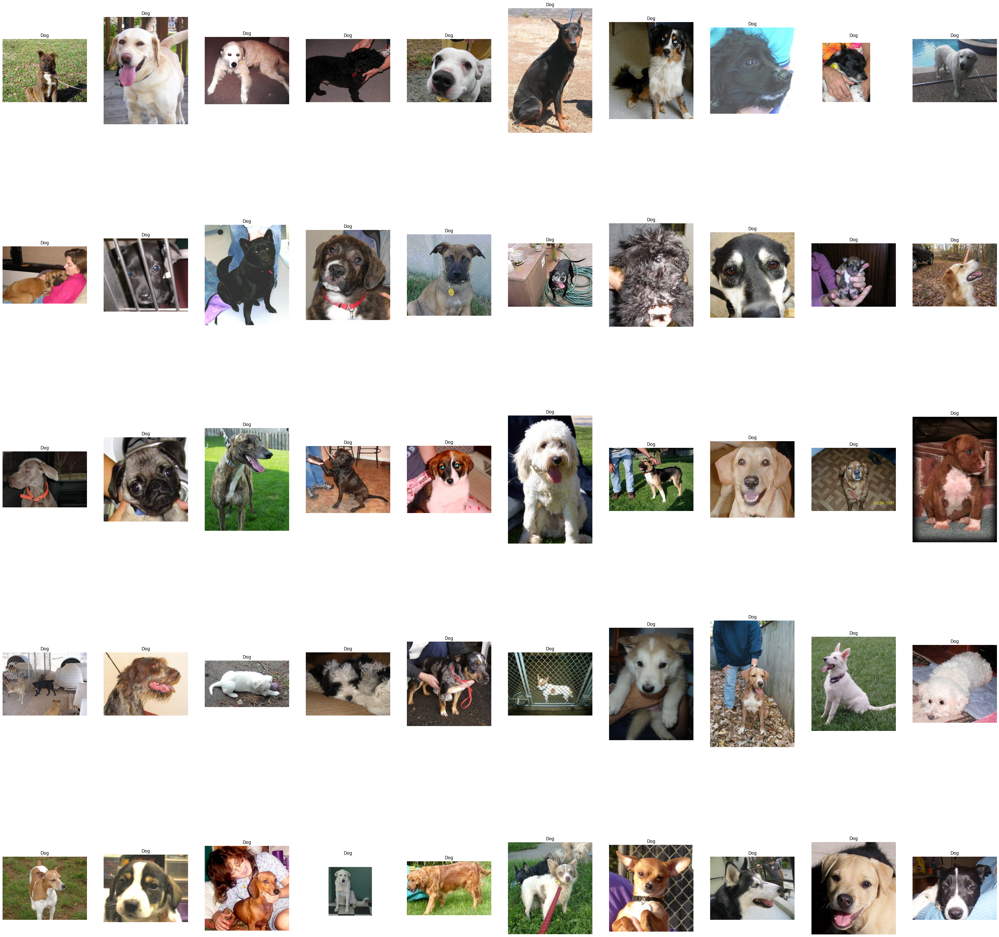

In [ ]:
import random

#Dog data analysis
plt.figure(figsize=(50,50))
temp = df[df['label']==1]['input_path']
start = random.randint(0,len(temp)-50) if len(temp) >= 50 else 0
files = temp[start:start+50]

for index, file in enumerate(files):
  plt.subplot(5,10, index+1)
  img = load_img(file)
  img = np.array(img)
  plt.imshow(img)
  plt.title('Dog')
  plt.axis('off')

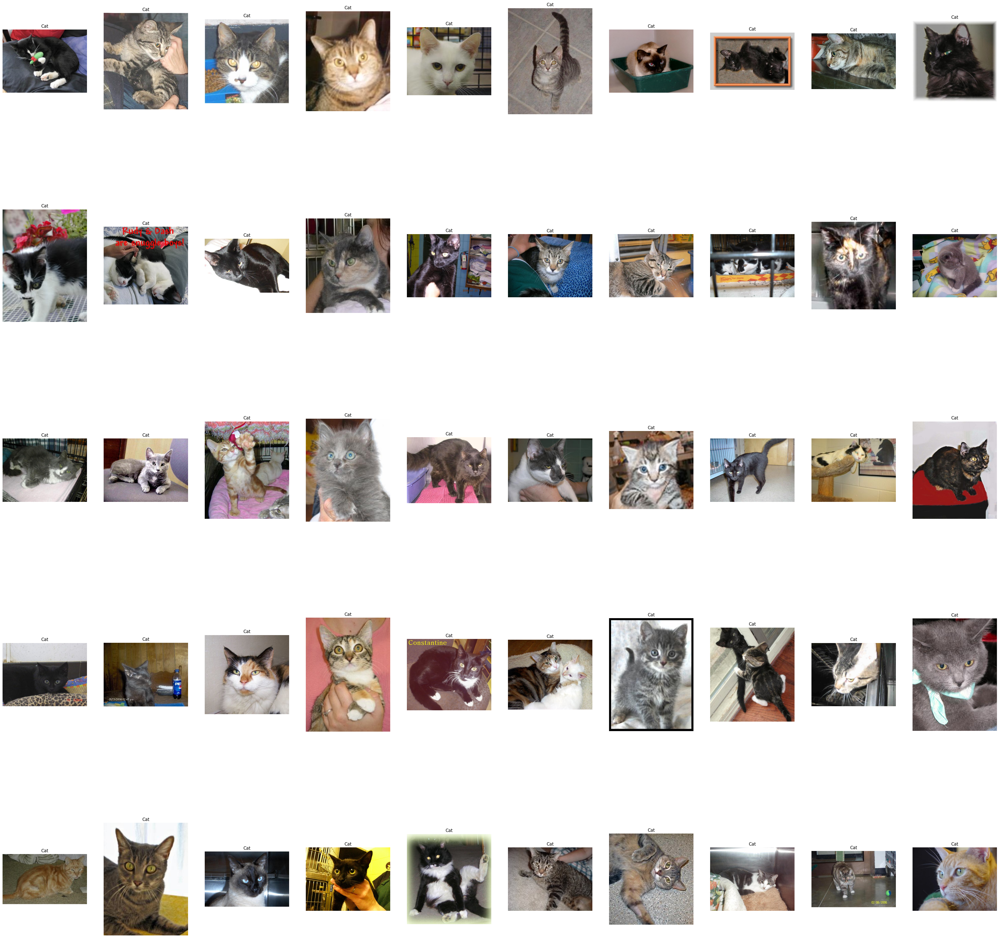

In [ ]:
import random

#Cat data analysis
plt.figure(figsize=(50,50))
temp = df[df['label']==0]['input_path']
start = random.randint(0,len(temp)-50) if len(temp) >= 50 else 0
files = temp[start:start+50]

for index, file in enumerate(files):
  plt.subplot(5,10, index+1)
  img = load_img(file)
  img = np.array(img)
  plt.imshow(img)
  plt.title('Cat')
  plt.axis('off')

<Axes: xlabel='label', ylabel='count'>

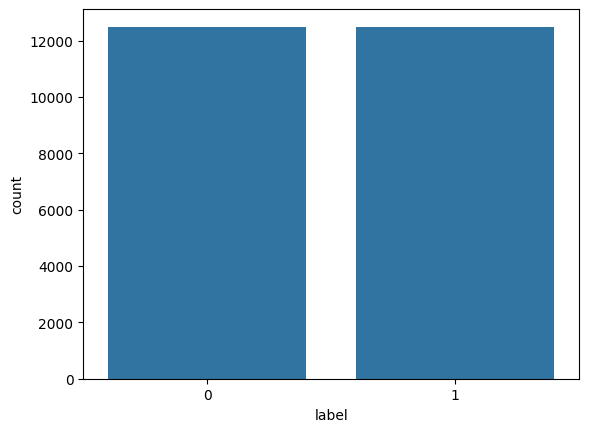

In [ ]:
import seaborn as sns
sns.countplot(x='label', data=df)

In [ ]:
df['label'] = df['label'].astype('str')
df.head()

,input_path,label
0,PetImages/Dog/9878.jpg,1
1,PetImages/Cat/3154.jpg,0
2,PetImages/Dog/494.jpg,1
3,PetImages/Dog/2163.jpg,1
4,PetImages/Dog/1827.jpg,1


In [ ]:
#Split
from sklearn.model_selection import train_test_split
train_df, test_df = train_test_split(df, test_size=0.2, random_state=42)

In [ ]:
train_df.head()

,input_path,label
23288,PetImages/Dog/10190.jpg,1
17781,PetImages/Dog/1516.jpg,1
1020,PetImages/Cat/11036.jpg,0
12644,PetImages/Cat/8915.jpg,0
1533,PetImages/Dog/2530.jpg,1


In [ ]:
test_df.head()

,input_path,label
6868,PetImages/Cat/10874.jpg,0
22911,PetImages/Cat/634.jpg,0
9668,PetImages/Cat/7301.jpg,0
13638,PetImages/Dog/1220.jpg,1
23339,PetImages/Dog/3105.jpg,1


In [ ]:
#Data generator

from tensorflow.keras.preprocessing.image import ImageDataGenerator

train_imageGenerator = ImageDataGenerator(#Augmentation process
    rescale=1./255,
    rotation_range=40,
    shear_range = 0.2,
    zoom_range = 0.2,
    horizontal_flip = True,
    fill_mode = 'nearest'
)

val_imageGenerator = ImageDataGenerator(rescale=1./255)

train_iterator = train_imageGenerator.flow_from_dataframe(
    dataframe = train_df, x_col = "input_path", y_col = "label", target_size = (128,128), batch_size = 512, class_mode = 'binary')

val_iterator = val_imageGenerator.flow_from_dataframe(
    dataframe = test_df, x_col = "input_path", y_col = "label", target_size = (128,128), batch_size = 512, class_mode = 'binary')

Found 19998 validated image filenames belonging to 2 classes.
Found 5000 validated image filenames belonging to 2 classes.


In [ ]:
#Model

from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout

model = Sequential([
    Conv2D(16, (3,3), activation='relu', input_shape=(128,128,3)),
    MaxPooling2D(2,2),
    Conv2D(32, (3,3), activation='relu'),
    MaxPooling2D(2,2),
    Conv2D(64, (3,3), activation='relu'),
    MaxPooling2D(2,2),
    Flatten(),
    Dense(512, activation='relu'),
    Dense(1, activation='sigmoid')
])

In [ ]:
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
model.summary()

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_6 (Conv2D)               │ (None, 126, 126, 16)   │           448 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_6 (MaxPooling2D)  │ (None, 63, 63, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 61, 61, 32)     │         4,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_7 (MaxPooling2D)  │ (None, 30, 30, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_8 (Conv2D)               │ (None, 28, 28, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_8 (MaxPooling2D)  │ (None, 14, 14, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_2 (Flatten)             │ (None, 12544)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 512)            │     6,423,040 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 1)              │           513 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,447,137 (24.59 MB)

 Trainable params: 6,447,137 (24.59 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
history = model.fit(train_iterator, epochs=50, validation_data = val_iterator)

Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 111s 3s/step - accuracy: 0.5510 - loss: 0.6817 - val_accuracy: 0.6666 - val_loss: 0.6103
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 105s 3s/step - accuracy: 0.6618 - loss: 0.6182 - val_accuracy: 0.7144 - val_loss: 0.5538
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 105s 3s/step - accuracy: 0.7008 - loss: 0.5739 - val_accuracy: 0.7268 - val_loss: 0.5507
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 105s 3s/step - accuracy: 0.7030 - loss: 0.5689 - val_accuracy: 0.7650 - val_loss: 0.4943
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 105s 3s/step - accuracy: 0.7333 - loss: 0.5270 - val_accuracy: 0.7732 - val_loss: 0.4777
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 106s 3s/step - accuracy: 0.7478 - loss: 0.5115 - val_accuracy: 0.7704 - val_loss: 0.4828
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 108s 3s/step - accuracy: 0.7551 - loss: 0.5031 - val_accuracy: 0.7748 - val_loss: 0.4732
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 106s 3s/step - accuracy: 0.7726 - loss: 0.4764 - val_accuracy: 0.7886 - v

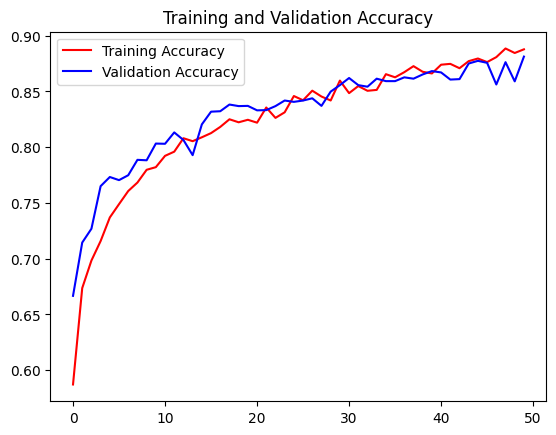

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
epochs = range(len(acc))

plt.plot(epochs, acc, 'r', label='Training Accuracy')
plt.plot(epochs, val_acc, 'b', label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.legend()
plt.show()

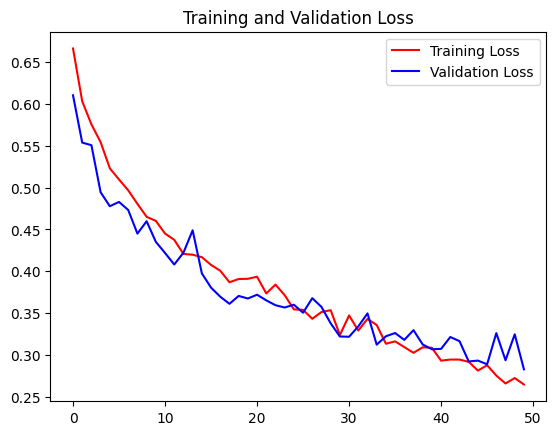

In [ ]:
loss = history.history['loss']
val_loss = history.history['val_loss']

plt.plot(epochs, loss, 'r', label='Training Loss')
plt.plot(epochs, val_loss, 'b', label='Validation Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.show()

In [ ]:
model.save("cats_dogs_classifier_model.h5")

In [ ]:
!zip -r PetImages.zip /content/PetImages
!zip -r sample_data.zip /content/sample_data


Streaming output truncated to the last 5000 lines.
  adding: content/PetImages/Cat/5244.jpg (deflated 3%)
  adding: content/PetImages/Cat/9300.jpg (deflated 0%)
  adding: content/PetImages/Cat/315.jpg (deflated 1%)
  adding: content/PetImages/Cat/4646.jpg (deflated 0%)
  adding: content/PetImages/Cat/7947.jpg (deflated 0%)
  adding: content/PetImages/Cat/3941.jpg (deflated 0%)
  adding: content/PetImages/Cat/2782.jpg (deflated 0%)
  adding: content/PetImages/Cat/10120.jpg (deflated 0%)
  adding: content/PetImages/Cat/4583.jpg (deflated 1%)
  adding: content/PetImages/Cat/8218.jpg (deflated 0%)
  adding: content/PetImages/Cat/6723.jpg (deflated 4%)
  adding: content/PetImages/Cat/7600.jpg (deflated 0%)
  adding: content/PetImages/Cat/5253.jpg (deflated 3%)
  adding: content/PetImages/Cat/11411.jpg (deflated 0%)
  adding: content/PetImages/Cat/5262.jpg (deflated 0%)
  adding: content/PetImages/Cat/397.jpg (deflated 0%)
  adding: content/PetImages/Cat/9430.jpg (deflated 3%)
  adding: cont

In [ ]:
from google.colab import files

files.download('PetImages.zip')
files.download('sample_data.zip')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>